Index(['source', 'target', 'rating', 'time'], dtype='object')
Nombre de nœuds : 5881
Nombre d'arêtes : 35592


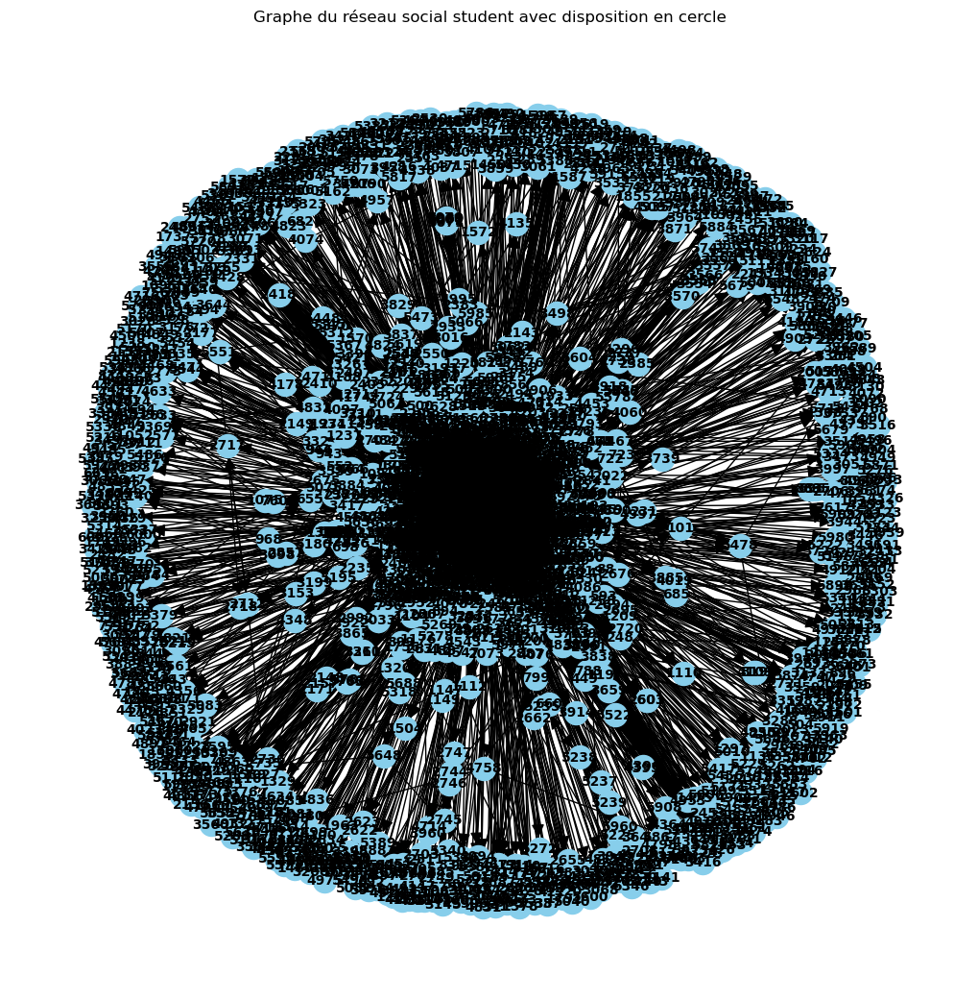

In [2]:
import pandas as pd 
import networkx as nx 
import matplotlib.pyplot as plt
df=pd.read_csv("C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv",names=['source', 'target', 'rating', 'time'])
df.head()
# Chemin du fichier CSV
file_path = 'C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv'

# Lire les premières lignes du fichier CSV pour identifier les noms des colonnes
df_sample = pd.read_csv(file_path, nrows=5,names=['source', 'target', 'rating', 'time'])
print(df_sample.columns)
G = nx.from_pandas_edgelist(df, source='source', target='target',edge_attr=["rating", "time"], create_using=nx.DiGraph())
# Afficher des informations sur le graphe
print("Nombre de nœuds :", G.number_of_nodes())
print("Nombre d'arêtes :", G.number_of_edges())

# Visualiser le graphe
plt.figure(figsize=(10, 10))
#pos = nx.circular_layout(G)
nx.draw(G, with_labels=True, node_size=300, node_color='skyblue', font_size=10, font_weight='bold', arrowsize=20)
plt.title("Graphe du réseau social student avec disposition en cercle")
plt.show()

In [3]:
import csv

# Lire le fichier CSV sans spécifier de titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Vérifier si le graphe est dirigé
is_directed = False
for edge in data:
    source = edge[0]
    target = edge[1]
    if source != target:
        is_directed = True
        break

if is_directed:
    print("Le graphe est dirigé.")
else:
    print("Le graphe n'est pas dirigé.")


Le graphe est dirigé.


# analyse la distribution des degrés dans le réseau Bitcoin OTC

Nœud 6: Degré 84
Nœud 2: Degré 86
Nœud 5: Degré 6
Nœud 1: Degré 441
Nœud 15: Degré 28
Nœud 4: Degré 117
Nœud 3: Degré 21
Nœud 13: Degré 401
Nœud 16: Degré 1
Nœud 10: Degré 13
Nœud 7: Degré 448
Nœud 21: Degré 48
Nœud 20: Degré 10
Nœud 8: Degré 4
Nœud 17: Degré 45
Nœud 23: Degré 44
Nœud 25: Degré 113
Nœud 26: Degré 23
Nœud 28: Degré 18
Nœud 29: Degré 68
Nœud 31: Degré 4
Nœud 32: Degré 12
Nœud 34: Degré 6
Nœud 35: Degré 1298
Nœud 36: Degré 68
Nœud 37: Degré 25
Nœud 44: Degré 5
Nœud 39: Degré 50
Nœud 45: Degré 22
Nœud 19: Degré 22
Nœud 46: Degré 2
Nœud 47: Degré 4
Nœud 51: Degré 59
Nœud 52: Degré 2
Nœud 53: Degré 4
Nœud 54: Degré 14
Nœud 41: Degré 195
Nœud 55: Degré 2
Nœud 57: Degré 139
Nœud 61: Degré 14
Nœud 65: Degré 2
Nœud 56: Degré 13
Nœud 66: Degré 2
Nœud 69: Degré 16
Nœud 70: Degré 12
Nœud 71: Degré 2
Nœud 72: Degré 22
Nœud 74: Degré 2
Nœud 75: Degré 17
Nœud 68: Degré 10
Nœud 64: Degré 147
Nœud 76: Degré 6
Nœud 77: Degré 35
Nœud 78: Degré 18
Nœud 60: Degré 129
Nœud 79: Degré 2
Nœud 8

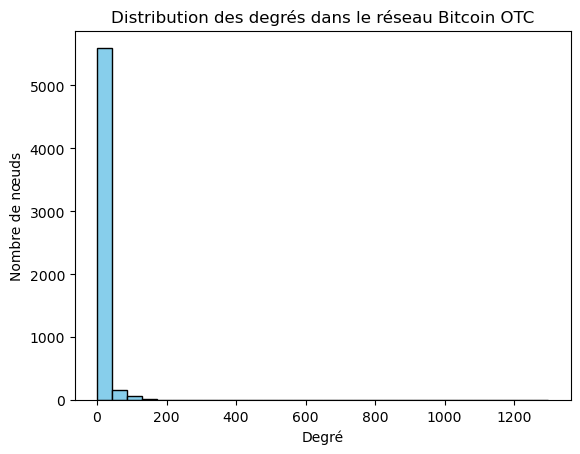

In [23]:
import networkx as nx
import matplotlib.pyplot as plt

# Charger les données depuis le fichier CSV
file_path = 'C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv'  # Remplacez par le chemin de votre fichier CSV

G = nx.read_edgelist('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', delimiter=',', data=[('rating', int), ('time', float)], create_using=nx.DiGraph())

# Calculer les degrés des nœuds dans le réseau
degree_sequence = sorted([d for n, d in G.degree()], reverse=True)

degrees = dict(G.degree())

# Afficher les degrés de chaque nœud sous forme de liste
for node, degree in degrees.items():
    print(f"Nœud {node}: Degré {degree}")

# Créer un histogramme de la distribution des degrés
plt.hist(degree_sequence, bins=30, color='skyblue', edgecolor='black')
plt.title("Distribution des degrés dans le réseau Bitcoin OTC")
plt.xlabel("Degré")
plt.ylabel("Nombre de nœuds")
plt.show()


In [7]:
import networkx as nx

# Charger le fichier CSV dans un graphe
G = nx.read_edgelist('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', delimiter=',', data=[('rating', int), ('time', float)])

# Calculer les degrés des nœuds
degree_dict = dict(G.degree())

# Déterminer le degré maximal et minimal
max_degree = max(degree_dict.values())
min_degree = min(degree_dict.values())

# Définir le nombre d'intervales pour la classification des degrés
num_intervals = 5

# Calculer la taille de chaque intervalle
interval_size = (max_degree - min_degree) / num_intervals

# Initialiser une liste pour chaque intervalle
intervals = [[] for _ in range(num_intervals)]

# Classer les nœuds dans les intervalles
for node, degree in degree_dict.items():
    interval_index = min(int((degree - min_degree) / interval_size), num_intervals - 1)
    intervals[interval_index].append(node)

# Afficher les nœuds dans chaque intervalle
for i, interval in enumerate(intervals):
    interval_start = min_degree + i * interval_size
    interval_end = min_degree + (i + 1) * interval_size
    
    # Vérifier si la longueur de l'intervalle est supérieure à 1000
    if len(interval) > 1000:
        print(f"Intervalle [{interval_start:.2f}, {interval_end:.2f}]: {len(interval)} nœuds")
    else:
        print(f"Intervalle [{interval_start:.2f}, {interval_end:.2f}]: {', '.join(interval)}")

# Afficher les nœuds avec le degré maximal et minimal
max_degree_nodes = [node for node, degree in degree_dict.items() if degree == max_degree]
min_degree_nodes = [node for node, degree in degree_dict.items() if degree == min_degree]
print(f"Nœuds avec le degré maximal ({max_degree}): {', '.join(max_degree_nodes)}")
print(f"Nœuds avec le degré minimal ({min_degree}): {len(min_degree_nodes)}")




Intervalle [1.00, 159.80]: 5856 nœuds
Intervalle [159.80, 318.60]: 1, 13, 7, 546, 1018, 1334, 1352, 1396, 1386, 1953, 2045, 2067, 2296, 2388, 3129, 3988, 4172, 4197, 4291
Intervalle [318.60, 477.40]: 905, 1810, 2028, 2125, 2642
Intervalle [477.40, 636.20]: 
Intervalle [636.20, 795.00]: 35
Nœuds avec le degré maximal (795): 35
Nœuds avec le degré minimal (1): 2260


# analyse des composantes connectée

Composant connecté 1 :
Nombre de nœuds : 5875
Centralité des  nœuds : {'2653': 0.0, '1410': 0.0, '1443': 0.0, '4637': 0.0, '1019': 0.0, '4350': 0.004008016032064128, '3562': 0.0, '3878': 0.01002004008016032, '1260': 0.0, '3522': 0.002004008016032064, '4352': 0.0, '4421': 0.004008016032064128, '5224': 0.0, '3873': 0.0, '2114': 0.0, '3241': 0.0, '2303': 0.01002004008016032, '4572': 0.0, '5646': 0.0, '4089': 0.0, '972': 0.0, '2843': 0.0, '5821': 0.0, '276': 0.0, '4287': 0.004008016032064128, '1786': 0.0, '266': 0.0, '820': 0.002004008016032064, '2799': 0.0, '3145': 0.0, '1064': 0.0, '2436': 0.0, '464': 0.0, '1073': 0.004008016032064128, '4571': 0.0, '3929': 0.0, '3016': 0.0, '5318': 0.0, '4687': 0.002004008016032064, '1682': 0.0, '1076': 0.002004008016032064, '2686': 0.0, '1713': 0.0, '1444': 0.0, '5691': 0.002004008016032064, '3850': 0.004008016032064128, '844': 0.002004008016032064, '2742': 0.004008016032064128, '64': 0.01603206412825651, '2917': 0.0, '4330': 0.0, '70': 0.0, '3945': 0.0

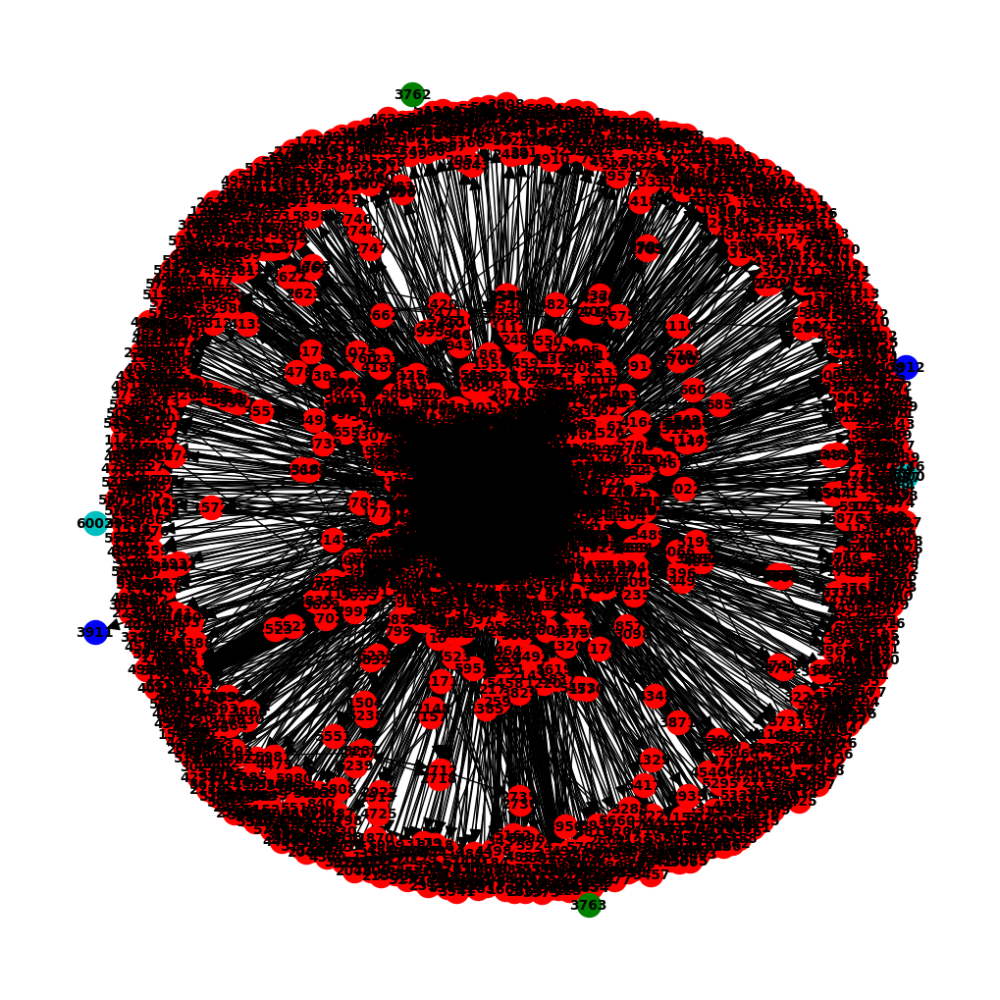

In [14]:
import networkx as nx
import matplotlib.pyplot as plt
import csv

# Lire le fichier CSV sans spécifier de titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Créer un graphe dirigé
G = nx.DiGraph()

# Ajouter les arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    # Convertir les attributs en dictionnaire
    attributes = {'rating': int(edge[2]), 'time': float(edge[3])}
    G.add_edge(source, target, **attributes)

# Trouver les composants connectés
connected_components = list(nx.weakly_connected_components(G))

# Liste des couleurs pour colorer les composants connectés
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']

# Afficher les informations pour chaque composant connecté
for i, component in enumerate(connected_components):
    print("Composant connecté", i+1, ":")
    if len(component) > 1000:
        print("Nombre de nœuds :", len(component))
        component_list = list(component)
        subgraph = G.subgraph(component_list[:500])
        central_nodes = nx.degree_centrality(subgraph)
        print("Centralité des  nœuds :", central_nodes)
        print("...")
    else:
        print("Nœuds :", component)
        print("Nombre de nœuds :", len(component))
        print("Nœuds :", component)
        subgraph = G.subgraph(component)
        central_nodes = nx.degree_centrality(subgraph)
        print("Centralité des nœuds :", central_nodes)
    
    print("")



# Visualiser chaque composant connecté avec une couleur différente
plt.figure(figsize=(10, 10))
for i, component in enumerate(connected_components):
    subgraph = G.subgraph(component)
    nx.draw(subgraph, with_labels=True, node_size=300, node_color=colors[i % len(colors)], font_size=10, font_weight='bold', arrowsize=20)
plt.show()



# analyse des chemins

In [30]:
import networkx as nx
import csv

# Lire le fichier CSV sans spécifier de titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Créer un graphe dirigé
G = nx.DiGraph()

# Ajouter les arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    # Convertir les attributs en dictionnaire
    attributes = {'rating': int(edge[2]), 'time': float(edge[3])}
    G.add_edge(source, target, **attributes)

# Obtenir tous les composants connectés
connected_components = nx.weakly_connected_components(G)

# Pour chaque composant connecté
for i, component in enumerate(connected_components):
    print(f"Composant connecté {i + 1}:")
    print("Nombre de nœuds :", len(component))

    # Créer un sous-graphe pour le composant connecté actuel
    component_subgraph = G.subgraph(component).copy()

    # Vérifier si le sous-graphe est fortement connecté
    if not nx.is_strongly_connected(component_subgraph):
        # Si le sous-graphe n'est pas fortement connecté, obtenir les plus grands composants connectés
        largest_components = max(nx.strongly_connected_components(component_subgraph), key=len)
        # Créer un sous-graphe avec les plus grands composants connectés
        component_subgraph = component_subgraph.subgraph(largest_components).copy()

    # Calculer différentes métriques de chemins
    if nx.number_of_nodes(component_subgraph) > 1:
        average_shortest_path_length = nx.average_shortest_path_length(component_subgraph)
        diameter = nx.diameter(component_subgraph)
        print("Longueur moyenne des chemins les plus courts :", average_shortest_path_length)
        print("Diamètre du réseau :", diameter)
    else:
        print("Composant connecté avec un seul nœud : pas de calcul de chemins.")
    print()


Composant connecté 1:
Nombre de nœuds : 5875
Longueur moyenne des chemins les plus courts : 3.6783612085752746
Diamètre du réseau : 11

Composant connecté 2:
Nombre de nœuds : 2
Longueur moyenne des chemins les plus courts : 1.0
Diamètre du réseau : 1

Composant connecté 3:
Nombre de nœuds : 2
Longueur moyenne des chemins les plus courts : 1.0
Diamètre du réseau : 1

Composant connecté 4:
Nombre de nœuds : 2
Composant connecté avec un seul nœud : pas de calcul de chemins.



# Coefficient de clustering et densité

In [5]:
import networkx as nx
import csv

# Lire le fichier CSV sans spécifier de titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Créer un graphe non dirigé
G = nx.Graph()

# Ajouter les arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    # Convertir les attributs en dictionnaire
    attributes = {'rating': int(edge[2]), 'time': float(edge[3])}
    G.add_edge(source, target, **attributes)

# Calculer le coefficient de clustering moyen
average_clustering = nx.average_clustering(G)

# Calculer la densité du réseau
density = nx.density(G)


# Afficher les résultats
print("Coefficient de clustering moyen :", average_clustering)
print("Densité du réseau :", density)


Coefficient de clustering moyen : 0.17750449405289517
Densité du réseau : 0.001243020588612932


# Analyse de la centralité 

In [5]:
import networkx as nx
import csv

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe dirigé
G = nx.DiGraph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    # Convertir les attributs en dictionnaire
    attributes = {'rating': int(edge[2]), 'time': float(edge[3])}
    G.add_edge(source, target, **attributes)

# Sélection des 100 premiers nœuds
top_nodes = list(G.nodes())[:50]

# Sous-graphe contenant uniquement les 100 premiers nœuds
subgraph = G.subgraph(top_nodes)

# Calcul des mesures de centralité pour le sous-graphe
degree_centrality = nx.degree_centrality(subgraph)  # Centralité de degré
betweenness_centrality = nx.betweenness_centrality(subgraph)  # Centralité d'intermédiarité
closeness_centrality = nx.closeness_centrality(subgraph)  # Centralité de proximité

# Affichage des résultats
print("Centralité de degré :", degree_centrality)
print("Centralité d'intermédiarité :", betweenness_centrality)
print("Centralité de proximité :", closeness_centrality)


Centralité de degré : {'65': 0.04081632653061224, '26': 0.08163265306122448, '72': 0.08163265306122448, '44': 0.08163265306122448, '52': 0.04081632653061224, '34': 0.12244897959183673, '45': 0.16326530612244897, '10': 0.26530612244897955, '29': 0.2040816326530612, '31': 0.08163265306122448, '7': 1.0612244897959182, '2': 0.42857142857142855, '41': 0.3877551020408163, '61': 0.1020408163265306, '68': 0.12244897959183673, '21': 0.3061224489795918, '19': 0.16326530612244897, '13': 0.5306122448979591, '37': 0.08163265306122448, '5': 0.12244897959183673, '71': 0.04081632653061224, '75': 0.08163265306122448, '32': 0.12244897959183673, '53': 0.08163265306122448, '46': 0.04081632653061224, '4': 0.6938775510204082, '54': 0.2040816326530612, '20': 0.12244897959183673, '8': 0.08163265306122448, '17': 0.3061224489795918, '36': 0.2857142857142857, '6': 0.32653061224489793, '55': 0.04081632653061224, '15': 0.08163265306122448, '57': 0.14285714285714285, '1': 1.2448979591836733, '70': 0.122448979591836

## l'algorithme de détection de communauté 
### Louvain

In [3]:
!pip install python-louvain

  Using cached python-louvain-0.16.tar.gz (204 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for python-louvain: filename=python_louvain-0.16-py3-none-any.whl size=9403 sha256=ff33a4b04283630813de28ab74a9dff4c34b99fdafb3233cfce4e51a4d96bac4
  Stored in directory: c:\users\pc\appdata\local\pip\cache\wheels\11\c1\e7\f62a211c636275e2da798bf0c307a3ae79aeddaf2524a03ce4
Successfully built python-louvain


Taille de chaque communauté (en nombre de nœuds) : {14: 1210, 19: 968, 2: 528, 3: 1102, 6: 543, 5: 720, 21: 290, 7: 68, 9: 4, 8: 88, 12: 51, 20: 11, 17: 3, 18: 3, 11: 193, 10: 58, 15: 26, 0: 3, 1: 2, 4: 2, 13: 6, 16: 2}
Centres de chaque communauté : {14: '1', 19: '1334', 2: '35', 3: '905', 6: '3129', 5: '2642', 21: '1810', 7: '1217', 9: '509', 8: '546', 12: '570', 20: '1078', 17: '1110', 18: '1147', 11: '2125', 10: '4315', 15: '1939', 0: '3540', 1: '3762', 4: '3911', 13: '5631', 16: '6000'}
Nombre total de communautés : 22
Modularité globale du réseau : 0.48819979012009684


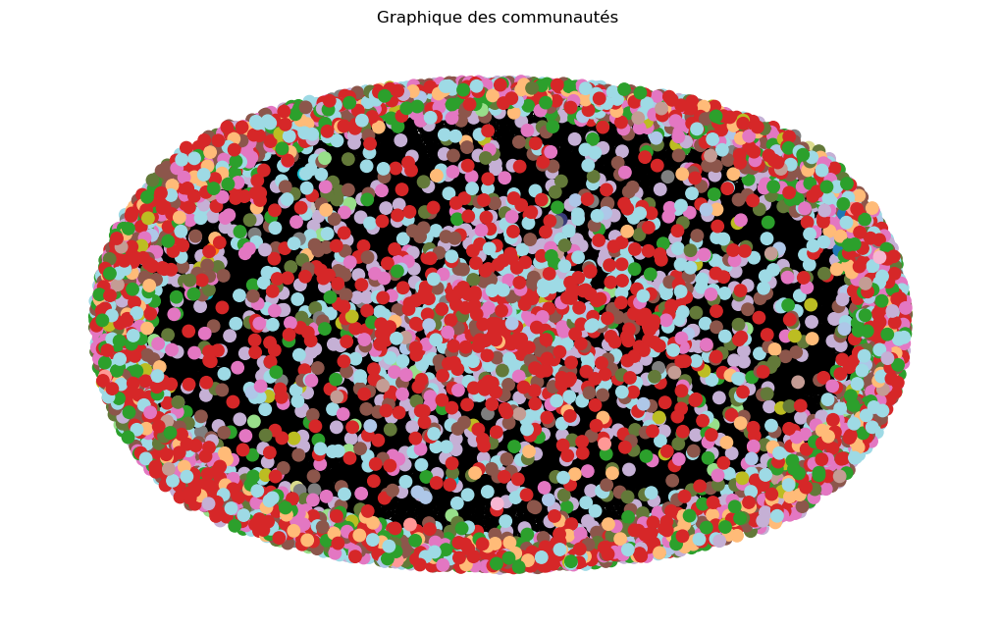

In [24]:
import csv
import community
import networkx as nx
import matplotlib.pyplot as plt

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe non dirigé
G = nx.Graph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    G.add_edge(source, target)

# Détection des communautés avec l'algorithme Louvain
partition = community.best_partition(G)

# Création d'un dictionnaire pour stocker les nœuds de chaque communauté
communities = {}
for node, community_id in partition.items():
    if community_id not in communities:
        communities[community_id] = [node]
    else:
        communities[community_id].append(node)

# Affichage des détails de chaque communauté
community_sizes = {community_id: len(nodes) for community_id, nodes in communities.items()}
print("Taille de chaque communauté (en nombre de nœuds) :", community_sizes)

# Calcul des centres de chaque communauté (nœud avec le degré maximal)
community_centers = {}
for community_id, nodes in communities.items():
    max_degree_node = max(nodes, key=lambda x: G.degree[x])
    community_centers[community_id] = max_degree_node
print("Centres de chaque communauté :", community_centers)

# Affichage du nombre total de communautés
total_communities = len(communities)
print("Nombre total de communautés :", total_communities)

# Calcul de la modularité globale du réseau
modularity = community.modularity(partition, G)
print("Modularité globale du réseau :", modularity)
colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
    '#c49c94', '#f7b6d2', '#c7c7c7', '#dbdb8d', '#9edae5',
    '#393b79', '#637939', '#8c6d31', '#843c39', '#7b4173'
]
# Dessin du graphique des communautés
plt.figure(figsize=(10, 6))
pos = nx.spring_layout(G, k=0.3, center=[0.5, 0.5])  # Définir la disposition des nœuds et les centrer
nx.draw(G, pos, node_color=[colors[partition[node]] for node in G.nodes()], cmap=plt.cm.Set1, node_size=80, with_labels=False)
plt.title('Graphique des communautés ')
plt.show()



# la détection de cliques

In [17]:
import csv
import networkx as nx

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe non dirigé
G = nx.Graph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    G.add_edge(source, target)

# Calcul de la densité du graphe
graph_density = nx.density(G)
print("Densité du graphe :", graph_density)

# Filtrage par densité : Ignorer les cliques dans les régions où la densité est faible
threshold_density = 0.1  # Ajustez cette valeur selon vos besoins
dense_subgraphs = [subgraph for subgraph in nx.find_cliques(G) if len(subgraph) >= 10 and nx.density(G.subgraph(subgraph)) >= threshold_density]

# Afficher les cliques détectées
for i, subgraph in enumerate(dense_subgraphs):
    print(f"Clique dense {i + 1} : nombre de noeuds = {len(subgraph)}")


Densité du graphe : 0.001243020588612932
Clique dense 1 : nombre de noeuds = 10
Clique dense 2 : nombre de noeuds = 11
Clique dense 3 : nombre de noeuds = 11
Clique dense 4 : nombre de noeuds = 10
Clique dense 5 : nombre de noeuds = 10
Clique dense 6 : nombre de noeuds = 10
Clique dense 7 : nombre de noeuds = 10
Clique dense 8 : nombre de noeuds = 10
Clique dense 9 : nombre de noeuds = 10
Clique dense 10 : nombre de noeuds = 10
Clique dense 11 : nombre de noeuds = 10
Clique dense 12 : nombre de noeuds = 10
Clique dense 13 : nombre de noeuds = 10
Clique dense 14 : nombre de noeuds = 10
Clique dense 15 : nombre de noeuds = 10
Clique dense 16 : nombre de noeuds = 10
Clique dense 17 : nombre de noeuds = 10
Clique dense 18 : nombre de noeuds = 10
Clique dense 19 : nombre de noeuds = 10
Clique dense 20 : nombre de noeuds = 11
Clique dense 21 : nombre de noeuds = 11
Clique dense 22 : nombre de noeuds = 10
Clique dense 23 : nombre de noeuds = 11
Clique dense 24 : nombre de noeuds = 11
Clique d

## l'algorithme de propagation des étiquettes

In [7]:
import networkx as nx
import csv
from networkx.algorithms.community import label_propagation_communities

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe non dirigé
G = nx.Graph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    G.add_edge(source, target)

# Utilisation de l'algorithme de propagation des étiquettes pour détecter les communautés
communities = list(label_propagation_communities(G))

# Afficher les communautés détectées sous forme de dictionnaire
community_dict = {f"Communauté {i + 1}": len(community) for i, community in enumerate(communities)}
print("Communautés détectées :", community_dict)


    

Communautés détectées : {'Communauté 1': 5515, 'Communauté 2': 3, 'Communauté 3': 4, 'Communauté 4': 2, 'Communauté 5': 4, 'Communauté 6': 2, 'Communauté 7': 2, 'Communauté 8': 2, 'Communauté 9': 3, 'Communauté 10': 17, 'Communauté 11': 7, 'Communauté 12': 3, 'Communauté 13': 2, 'Communauté 14': 2, 'Communauté 15': 3, 'Communauté 16': 3, 'Communauté 17': 2, 'Communauté 18': 5, 'Communauté 19': 2, 'Communauté 20': 2, 'Communauté 21': 2, 'Communauté 22': 3, 'Communauté 23': 3, 'Communauté 24': 2, 'Communauté 25': 3, 'Communauté 26': 2, 'Communauté 27': 2, 'Communauté 28': 4, 'Communauté 29': 11, 'Communauté 30': 3, 'Communauté 31': 4, 'Communauté 32': 3, 'Communauté 33': 2, 'Communauté 34': 2, 'Communauté 35': 2, 'Communauté 36': 2, 'Communauté 37': 3, 'Communauté 38': 2, 'Communauté 39': 2, 'Communauté 40': 3, 'Communauté 41': 2, 'Communauté 42': 2, 'Communauté 43': 2, 'Communauté 44': 2, 'Communauté 45': 2, 'Communauté 46': 52, 'Communauté 47': 4, 'Communauté 48': 2, 'Communauté 49': 3

# partie 4 : prediction des liens 

Coefficient de Jaccard et Adamic/Adar : Le coefficient de Jaccard mesure la probabilité que deux nœuds partagent un voisin commun, normalisé par la taille totale de leurs voisins. Adamic et Adar ont une mesure similaire, mais ils donnent plus de poids aux voisins rares.

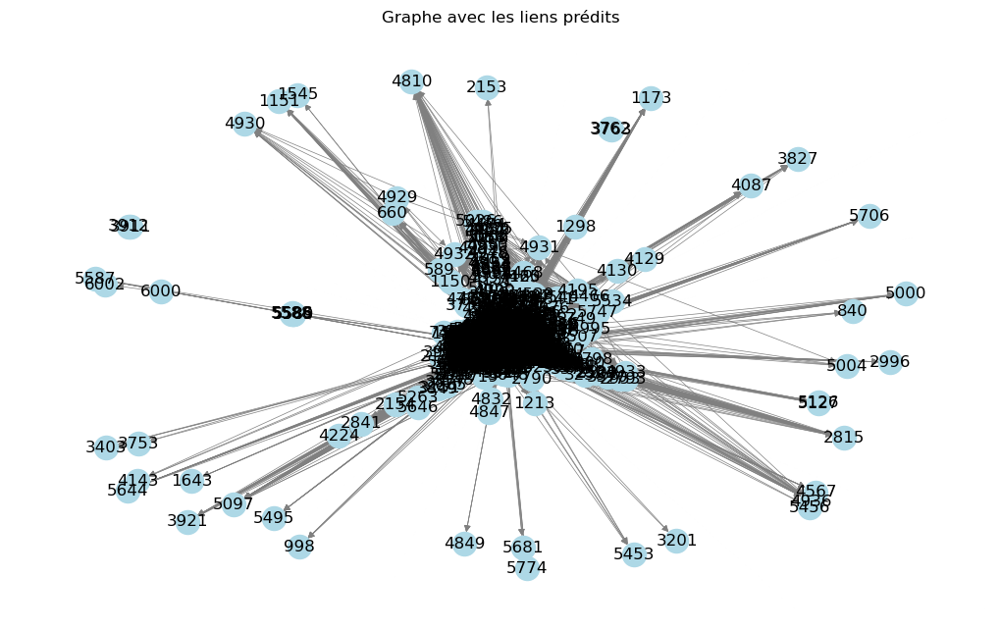

In [2]:
import csv
import networkx as nx
import matplotlib.pyplot as plt

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe dirigé
G = nx.DiGraph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    G.add_edge(source, target)


# Créer un graphe non dirigé à partir du graphe dirigé
undirected_G = G.to_undirected()

# Calcul du score de similarité Jaccard pour chaque paire de nœuds
jaccard_scores = nx.jaccard_coefficient(undirected_G)

# Calcul du score de similarité Adamic/Adar pour chaque paire de nœuds
adamic_adar_scores = nx.adamic_adar_index(undirected_G)



# Sélection des prédictions de liens basées sur les scores de Jaccard et Adamic/Adar
predicted_edges = [(u, v) for u, v, p in jaccard_scores if p > 0] + [(u, v) for u, v, p in adamic_adar_scores if p > 0]

# Création d'un sous-graphe contenant uniquement les liens prédits
predicted_graph = G.copy()
predicted_graph.add_edges_from(predicted_edges)

# Visualisation du graphe avec les liens prédits
plt.figure(figsize=(10, 6))
pos = nx.spring_layout(predicted_graph, seed=42)  # Définition de la disposition des nœuds
nx.draw(predicted_graph, pos, with_labels=True, node_color='lightblue', node_size=300, edge_color='gray', width=0.5)
plt.title("Graphe avec les liens prédits")
plt.show()



In [3]:
print("Nouveaux liens prédits :")
for edge in predicted_edges:
    print(edge)
    

Nouveaux liens prédits :
('46', '1444')
('46', '1442')
('46', '41')
('46', '390')
('46', '7')
('46', '1835')
('46', '1653')
('46', '2043')
('46', '1774')
('46', '1556')
('46', '35')
('46', '1562')
('46', '1217')
('46', '1821')
('46', '1')
('46', '3593')
('46', '15')
('46', '1228')
('46', '838')
('46', '202')
('46', '1831')
('46', '239')
('46', '88')
('46', '1893')
('46', '1761')
('46', '3450')
('46', '21')
('46', '492')
('46', '78')
('46', '500')
('46', '37')
('46', '678')
('46', '1844')
('46', '1748')
('46', '1745')
('46', '1615')
('973', '2877')
('973', '238')
('973', '982')
('973', '284')
('973', '902')
('973', '270')
('973', '535')
('973', '832')
('973', '418')
('973', '13')
('973', '633')
('973', '1007')
('973', '1026')
('973', '2266')
('973', '743')
('973', '780')
('973', '144')
('973', '810')
('1216', '115')
('1216', '1162')
('2005', '2476')
('2005', '4079')
('2005', '2446')
('2005', '3806')
('2005', '1447')
('2005', '1405')
('2005', '4066')
('2005', '3616')
('2005', '2087')
('2

('2002', '2292')
('2002', '4228')
('2002', '5421')
('2002', '3642')
('2002', '3197')
('2002', '5611')
('2002', '2315')
('2002', '2594')
('2002', '5563')
('2002', '4668')
('2002', '2548')
('2002', '3202')
('2002', '5096')
('2002', '4172')
('2002', '2617')
('2002', '4524')
('2002', '3307')
('2002', '4659')
('2002', '1201')
('2002', '4291')
('2002', '3076')
('2002', '4681')
('2002', '1334')
('2002', '283')
('2002', '1574')
('2002', '4245')
('2002', '2699')
('2002', '2140')
('2002', '2058')
('2002', '5001')
('2002', '5928')
('2002', '3919')
('2002', '1930')
('2002', '2924')
('2002', '3722')
('2002', '4413')
('2002', '2337')
('2002', '2629')
('2002', '2540')
('2002', '4870')
('2002', '2173')
('2002', '2297')
('2002', '5028')
('2002', '4423')
('2002', '4868')
('2002', '4708')
('2002', '5480')
('2002', '2395')
('2002', '4840')
('2002', '1539')
('2002', '3327')
('2002', '1860')
('2002', '1896')
('2002', '3146')
('2002', '3653')
('2002', '3465')
('2002', '2651')
('2002', '2602')
('2002', '2440'

('1192', '537')
('1192', '1383')
('1192', '547')
('1192', '13')
('1192', '1953')
('1192', '4304')
('1192', '1005')
('1192', '1404')
('1192', '4672')
('1192', '273')
('1192', '1248')
('1192', '5132')
('1192', '1252')
('1192', '363')
('1192', '1753')
('1192', '4666')
('1192', '1803')
('1192', '2724')
('1192', '5007')
('1192', '2067')
('1192', '2600')
('1192', '4400')
('1192', '957')
('1192', '4036')
('1192', '923')
('1192', '1811')
('1192', '2045')
('1192', '492')
('1192', '1226')
('1192', '2684')
('1192', '1907')
('1192', '2351')
('1192', '4649')
('1192', '606')
('1192', '493')
('1192', '5123')
('1192', '5403')
('1192', '726')
('1192', '4622')
('1192', '1820')
('1192', '135')
('1192', '4592')
('1192', '2466')
('1192', '873')
('1192', '2284')
('1192', '304')
('1192', '4744')
('1192', '1323')
('1192', '1888')
('1192', '2955')
('1192', '1333')
('1192', '2141')
('1192', '1363')
('1192', '1353')
('1192', '5192')
('1192', '908')
('1192', '898')
('1192', '2318')
('1192', '4531')
('1192', '540'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('2194', '2940')
('2194', '5711')
('2194', '4')
('2194', '469')
('2194', '3587')
('2194', '5927')
('2194', '5528')
('2194', '1222')
('2194', '2962')
('2194', '1624')
('2194', '3195')
('2194', '3002')
('2194', '3251')
('2194', '1484')
('2194', '2649')
('2194', '3754')
('2194', '1779')
('2194', '5605')
('2194', '4251')
('2194', '5366')
('2194', '1997')
('2194', '4681')
('2194', '4601')
('2194', '5998')
('2194', '1439')
('2194', '1762')
('2194', '5932')
('2194', '2797')
('2194', '2961')
('2194', '2462')
('2194', '1634')
('2194', '1697')
('2194', '2700')
('2194', '3502')
('2194', '5703')
('2194', '5859')
('2194', '2986')
('2194', '3378')
('2194', '5256')
('2194', '1457')
('2194', '3319')
('2194', '687')
('2194', '2244')
('2194', '5995')
('2194', '2706')
('2194', '2408')
('2194', '4399')
('2194', '208')
('2194', '2000')
('2194', '4747')
('2194', '4365')
('2194', '4093')
('2194', '3614')
('2194', '184')
('2194', '523')
('2194', '5147')
('2194', '3507')
('2194', '1806')
('2194', '1450')
('219

('2559', '2188')
('2559', '2632')
('2559', '3790')
('2559', '2312')
('2559', '2166')
('2559', '1634')
('2559', '3502')
('2559', '3378')
('2559', '3789')
('2559', '3897')
('2559', '2622')
('2559', '171')
('2559', '2472')
('2559', '2540')
('2559', '2570')
('2559', '255')
('2559', '2573')
('2559', '2606')
('2559', '2054')
('2559', '1953')
('2559', '2631')
('2559', '4304')
('2559', '4205')
('2559', '2453')
('2559', '5684')
('2559', '1810')
('2559', '5925')
('2559', '2346')
('2559', '2030')
('2559', '2634')
('2559', '4649')
('2559', '1921')
('2559', '2633')
('2559', '2168')
('2559', '4197')
('2559', '135')
('2559', '2367')
('2559', '4638')
('2559', '546')
('2559', '5449')
('2559', '5512')
('2559', '1675')
('2559', '635')
('2559', '2601')
('2559', '2569')
('2559', '3791')
('2559', '2640')
('2559', '1316')
('2559', '3574')
('2559', '251')
('2559', '6')
('2559', '2229')
('2559', '3786')
('2559', '1281')
('2559', '3988')
('2559', '1899')
('2559', '3001')
('2559', '3793')
('2559', '2597')
('2559

('4206', '3051')
('4206', '4065')
('4206', '1645')
('4206', '2302')
('4206', '1548')
('4206', '2379')
('4206', '1281')
('4206', '3988')
('4206', '2118')
('4206', '1899')
('4206', '2971')
('4206', '1288')
('4206', '3266')
('4206', '1788')
('4206', '3117')
('4206', '1052')
('4206', '4364')
('4206', '387')
('4206', '3718')
('4206', '1884')
('4206', '2413')
('4206', '3717')
('4206', '3228')
('4206', '2448')
('4206', '2985')
('4206', '1426')
('4206', '4822')
('4206', '1452')
('4206', '1018')
('4206', '3890')
('4206', '2496')
('4206', '2839')
('4206', '3106')
('4206', '4554')
('4206', '2784')
('4206', '5926')
('4206', '5825')
('4206', '3095')
('4206', '1136')
('4206', '1487')
('4206', '3037')
('4206', '1534')
('4206', '1552')
('4206', '215')
('4206', '2249')
('4206', '3735')
('4206', '96')
('4206', '2509')
('4206', '5867')
('4206', '3572')
('4206', '4667')
('4206', '1656')
('4206', '5652')
('4206', '3128')
('4206', '3137')
('4206', '4499')
('4206', '3156')
('4206', '3526')
('4206', '2663')
(

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('5203', '3521')
('5203', '2987')
('5203', '5852')
('5203', '3600')
('5203', '2891')
('5203', '4107')
('5203', '5407')
('5203', '25')
('5203', '4131')
('5203', '5289')
('5203', '2537')
('5203', '2984')
('5203', '2524')
('5203', '5525')
('5203', '2661')
('5203', '4361')
('5203', '4683')
('5203', '1204')
('5203', '3063')
('5203', '3646')
('5203', '3887')
('5203', '5625')
('5203', '5467')
('5203', '2682')
('5203', '1348')
('5203', '2276')
('5203', '5273')
('5203', '2553')
('5203', '3040')
('5203', '5709')
('5203', '5473')
('5203', '5395')
('5203', '4139')
('5203', '5159')
('5203', '3699')
('5203', '2416')
('5203', '4669')
('5203', '2683')
('5203', '2905')
('5203', '2396')
('5203', '2419')
('5203', '4347')
('5203', '5181')
('5203', '4701')
('5203', '1990')
('5203', '1735')
('5203', '2862')
('5203', '4816')
('5203', '2306')
('5203', '954')
('5203', '1499')
('5203', '5342')
('5203', '5471')
('5203', '2647')
('5203', '777')
('5203', '3531')
('5203', '4910')
('5203', '4098')
('5203', '1946')


('2602', '2559')
('2602', '1975')
('2602', '1764')
('2602', '135')
('2602', '2367')
('2602', '4638')
('2602', '5801')
('2602', '546')
('2602', '5449')
('2602', '3665')
('2602', '304')
('2602', '1817')
('2602', '4744')
('2602', '3841')
('2602', '5086')
('2602', '1546')
('2602', '4665')
('2602', '2741')
('2602', '5413')
('2602', '2726')
('2602', '4844')
('2602', '5512')
('2602', '4531')
('2602', '1612')
('2602', '1675')
('2602', '1917')
('2602', '2062')
('2602', '3791')
('2602', '2640')
('2602', '405')
('2602', '1316')
('2602', '2083')
('2602', '2065')
('2602', '3574')
('2602', '2229')
('2602', '3810')
('2602', '2698')
('2602', '1281')
('2602', '3337')
('2602', '3988')
('2602', '1899')
('2602', '3001')
('2602', '1052')
('2602', '2929')
('2602', '4732')
('2602', '3760')
('2602', '1018')
('2602', '2556')
('2602', '215')
('2602', '4033')
('2602', '2732')
('2602', '4458')
('2602', '5216')
('2602', '4499')
('2602', '2201')
('2602', '2273')
('2602', '4804')
('2602', '2925')
('2602', '3233')
('

('1880', '1689')
('1880', '635')
('1880', '5251')
('1880', '1757')
('1880', '1653')
('1880', '3699')
('1880', '2306')
('1880', '1499')
('1880', '251')
('1880', '4084')
('1880', '3531')
('1880', '2733')
('1880', '767')
('1880', '2125')
('1880', '1596')
('1880', '2118')
('1880', '1396')
('1880', '1477')
('1880', '927')
('1880', '2630')
('1880', '1600')
('1880', '19')
('1880', '1884')
('1880', '937')
('1880', '2099')
('1880', '4088')
('1880', '4925')
('1880', '3590')
('1880', '1487')
('1880', '1693')
('1880', '415')
('1880', '4590')
('1880', '57')
('1880', '361')
('1880', '4667')
('1880', '270')
('1880', '1479')
('1880', '4608')
('1880', '1704')
('1880', '1576')
('1880', '2755')
('1880', '1366')
('1880', '1970')
('1880', '1267')
('1880', '5008')
('1880', '3000')
('1880', '2296')
('1880', '1438')
('1880', '23')
('1880', '4284')
('1880', '4788')
('1880', '4987')
('1880', '4238')
('1880', '1981')
('1880', '3744')
('1880', '2725')
('1880', '4733')
('1880', '3366')
('1880', '64')
('1880', '469

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('2652', '2762')
('2652', '4524')
('2652', '2636')
('2652', '3669')
('2652', '4616')
('2652', '1201')
('2652', '3195')
('2652', '3002')
('2652', '2649')
('2652', '4681')
('2652', '1762')
('2652', '2961')
('2652', '2462')
('2652', '3378')
('2652', '4245')
('2652', '5001')
('2652', '184')
('2652', '1806')
('2652', '2747')
('2652', '1838')
('2652', '3287')
('2652', '2924')
('2652', '3897')
('2652', '2622')
('2652', '4413')
('2652', '2337')
('2652', '4501')
('2652', '2540')
('2652', '3293')
('2652', '2570')
('2652', '2573')
('2652', '2230')
('2652', '2897')
('2652', '4742')
('2652', '3476')
('2652', '537')
('2652', '5028')
('2652', '2819')
('2652', '4423')
('2652', '4868')
('2652', '3490')
('2652', '2218')
('2652', '1953')
('2652', '2631')
('2652', '5480')
('2652', '2395')
('2652', '4304')
('2652', '2328')
('2652', '3327')
('2652', '1619')
('2652', '1860')
('2652', '363')
('2652', '1896')
('2652', '4666')
('2652', '3653')
('2652', '4818')
('2652', '2651')
('2652', '3895')
('2652', '2666')


('5222', '1714')
('5222', '4587')
('5222', '5204')
('5222', '5436')
('5222', '2725')
('5222', '4911')
('5222', '4966')
('5222', '5189')
('5222', '2257')
('5222', '905')
('5222', '5349')
('5222', '5068')
('5222', '5149')
('5222', '5107')
('5222', '4370')
('5222', '5377')
('5222', '2536')
('5222', '3229')
('5222', '5195')
('5222', '5430')
('5222', '5316')
('5222', '5712')
('5222', '5243')
('5222', '2876')
('5222', '3462')
('5222', '4363')
('5222', '5335')
('5222', '3347')
('5222', '5406')
('5222', '5071')
('5222', '1585')
('5222', '2592')
('5222', '5786')
('5222', '5373')
('5222', '2090')
('5222', '4678')
('5222', '4611')
('5222', '2688')
('5222', '3568')
('5222', '550')
('5222', '2437')
('5222', '4684')
('5222', '3429')
('5222', '5067')
('5222', '4379')
('5222', '2195')
('5222', '246')
('5222', '2777')
('1805', '1')
('1805', '1765')
('1805', '1044')
('1805', '2028')
('1805', '1866')
('1805', '1865')
('1805', '1762')
('1805', '2000')
('1805', '1806')
('1805', '2079')
('1805', '1784')
('1

('1916', '2356')
('1916', '3296')
('1916', '2123')
('1916', '5718')
('1916', '2419')
('1916', '1910')
('1916', '5263')
('1916', '5475')
('1916', '199')
('1916', '1490')
('1916', '2177')
('1916', '1909')
('1916', '4542')
('1916', '1441')
('1916', '2065')
('1916', '3472')
('1916', '2306')
('1916', '1991')
('1916', '251')
('1916', '870')
('1916', '4028')
('1916', '3412')
('1916', '10')
('1916', '3836')
('1916', '5471')
('1916', '3668')
('1916', '2482')
('1916', '6')
('1916', '777')
('1916', '3531')
('1916', '1356')
('1916', '2733')
('1916', '2217')
('1916', '1823')
('1916', '3457')
('1916', '3786')
('1916', '5202')
('1916', '3342')
('1916', '3051')
('1916', '1946')
('1916', '4065')
('1916', '3257')
('1916', '3029')
('1916', '1645')
('1916', '1548')
('1916', '2379')
('1916', '1281')
('1916', '3988')
('1916', '2118')
('1916', '3702')
('1916', '1288')
('1916', '3266')
('1916', '1128')
('1916', '3117')
('1916', '3891')
('1916', '1052')
('1916', '4364')
('1916', '2929')
('1916', '387')
('1916'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [6]:
# Vérifier si les liens prédits existent parmi les liens originaux du graphe
for edge in predicted_edges:
    if edge in G.edges():
        print(f"Lien prédit {edge} trouvé dans les liens originaux.")
    else:
        print(f"Lien prédit {edge} non trouvé dans les liens originaux.")

Lien prédit ('46', '1444') non trouvé dans les liens originaux.
Lien prédit ('46', '1442') non trouvé dans les liens originaux.
Lien prédit ('46', '41') non trouvé dans les liens originaux.
Lien prédit ('46', '390') non trouvé dans les liens originaux.
Lien prédit ('46', '7') non trouvé dans les liens originaux.
Lien prédit ('46', '1835') non trouvé dans les liens originaux.
Lien prédit ('46', '1653') non trouvé dans les liens originaux.
Lien prédit ('46', '2043') non trouvé dans les liens originaux.
Lien prédit ('46', '1774') non trouvé dans les liens originaux.
Lien prédit ('46', '1556') non trouvé dans les liens originaux.
Lien prédit ('46', '35') non trouvé dans les liens originaux.
Lien prédit ('46', '1562') non trouvé dans les liens originaux.
Lien prédit ('46', '1217') non trouvé dans les liens originaux.
Lien prédit ('46', '1821') non trouvé dans les liens originaux.
Lien prédit ('46', '1') non trouvé dans les liens originaux.
Lien prédit ('46', '3593') non trouvé dans les lien

Lien prédit ('1269', '1221') non trouvé dans les liens originaux.
Lien prédit ('1269', '1266') non trouvé dans les liens originaux.
Lien prédit ('1269', '1262') non trouvé dans les liens originaux.
Lien prédit ('1269', '781') non trouvé dans les liens originaux.
Lien prédit ('1269', '1260') non trouvé dans les liens originaux.
Lien prédit ('1269', '1229') non trouvé dans les liens originaux.
Lien prédit ('1269', '25') non trouvé dans les liens originaux.
Lien prédit ('1269', '1346') non trouvé dans les liens originaux.
Lien prédit ('1269', '1348') non trouvé dans les liens originaux.
Lien prédit ('1269', '777') non trouvé dans les liens originaux.
Lien prédit ('1269', '1043') non trouvé dans les liens originaux.
Lien prédit ('1269', '1215') non trouvé dans les liens originaux.
Lien prédit ('1269', '270') non trouvé dans les liens originaux.
Lien prédit ('1269', '1195') non trouvé dans les liens originaux.
Lien prédit ('1269', '1227') non trouvé dans les liens originaux.
Lien prédit ('1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('2442', '2344') non trouvé dans les liens originaux.
Lien prédit ('2442', '5071') non trouvé dans les liens originaux.
Lien prédit ('2442', '3208') non trouvé dans les liens originaux.
Lien prédit ('2442', '3449') non trouvé dans les liens originaux.
Lien prédit ('2442', '3297') non trouvé dans les liens originaux.
Lien prédit ('2442', '2434') non trouvé dans les liens originaux.
Lien prédit ('2442', '3581') non trouvé dans les liens originaux.
Lien prédit ('2442', '2837') non trouvé dans les liens originaux.
Lien prédit ('2442', '3265') non trouvé dans les liens originaux.
Lien prédit ('2442', '5649') non trouvé dans les liens originaux.
Lien prédit ('2442', '481') non trouvé dans les liens originaux.
Lien prédit ('2442', '550') non trouvé dans les liens originaux.
Lien prédit ('2442', '2835') non trouvé dans les liens originaux.
Lien prédit ('2442', '2498') non trouvé dans les liens originaux.
Lien prédit ('2442', '2155') non trouvé dans les liens originaux.
Lien prédit 

Lien prédit ('2800', '2404') non trouvé dans les liens originaux.
Lien prédit ('2800', '2906') non trouvé dans les liens originaux.
Lien prédit ('2800', '2835') non trouvé dans les liens originaux.
Lien prédit ('2800', '3363') non trouvé dans les liens originaux.
Lien prédit ('2269', '5153') non trouvé dans les liens originaux.
Lien prédit ('2269', '4331') non trouvé dans les liens originaux.
Lien prédit ('2269', '5389') non trouvé dans les liens originaux.
Lien prédit ('2269', '1933') non trouvé dans les liens originaux.
Lien prédit ('2269', '465') non trouvé dans les liens originaux.
Lien prédit ('2269', '1053') non trouvé dans les liens originaux.
Lien prédit ('2269', '1964') non trouvé dans les liens originaux.
Lien prédit ('2269', '1584') non trouvé dans les liens originaux.
Lien prédit ('2269', '4247') non trouvé dans les liens originaux.
Lien prédit ('2269', '2639') non trouvé dans les liens originaux.
Lien prédit ('2269', '4192') non trouvé dans les liens originaux.
Lien prédit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('4787', '4406') non trouvé dans les liens originaux.
Lien prédit ('4787', '3501') non trouvé dans les liens originaux.
Lien prédit ('4787', '5352') non trouvé dans les liens originaux.
Lien prédit ('4787', '6005') non trouvé dans les liens originaux.
Lien prédit ('4787', '2625') non trouvé dans les liens originaux.
Lien prédit ('4787', '3199') non trouvé dans les liens originaux.
Lien prédit ('4787', '1593') non trouvé dans les liens originaux.
Lien prédit ('4787', '5885') non trouvé dans les liens originaux.
Lien prédit ('4787', '4204') non trouvé dans les liens originaux.
Lien prédit ('4787', '5737') non trouvé dans les liens originaux.
Lien prédit ('4787', '5206') non trouvé dans les liens originaux.
Lien prédit ('4787', '1802') non trouvé dans les liens originaux.
Lien prédit ('4787', '246') non trouvé dans les liens originaux.
Lien prédit ('4787', '2538') non trouvé dans les liens originaux.
Lien prédit ('4787', '2777') non trouvé dans les liens originaux.
Lien prédit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('1946', '5112') non trouvé dans les liens originaux.
Lien prédit ('1946', '1502') non trouvé dans les liens originaux.
Lien prédit ('1946', '4607') non trouvé dans les liens originaux.
Lien prédit ('1946', '4912') non trouvé dans les liens originaux.
Lien prédit ('1946', '2242') non trouvé dans les liens originaux.
Lien prédit ('1946', '5111') non trouvé dans les liens originaux.
Lien prédit ('1946', '3494') non trouvé dans les liens originaux.
Lien prédit ('1946', '2296') non trouvé dans les liens originaux.
Lien prédit ('1946', '2508') non trouvé dans les liens originaux.
Lien prédit ('1946', '5313') non trouvé dans les liens originaux.
Lien prédit ('1946', '184') non trouvé dans les liens originaux.
Lien prédit ('1946', '523') non trouvé dans les liens originaux.
Lien prédit ('1946', '1714') non trouvé dans les liens originaux.
Lien prédit ('1946', '4587') non trouvé dans les liens originaux.
Lien prédit ('1946', '3374') non trouvé dans les liens originaux.
Lien prédit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('35', '396') non trouvé dans les liens originaux.
Lien prédit ('35', '3560') non trouvé dans les liens originaux.
Lien prédit ('35', '3520') non trouvé dans les liens originaux.
Lien prédit ('35', '225') non trouvé dans les liens originaux.
Lien prédit ('35', '2284') non trouvé dans les liens originaux.
Lien prédit ('35', '672') non trouvé dans les liens originaux.
Lien prédit ('35', '1342') non trouvé dans les liens originaux.
Lien prédit ('35', '4116') non trouvé dans les liens originaux.
Lien prédit ('35', '5228') non trouvé dans les liens originaux.
Lien prédit ('35', '4744') non trouvé dans les liens originaux.
Lien prédit ('35', '3015') non trouvé dans les liens originaux.
Lien prédit ('35', '538') non trouvé dans les liens originaux.
Lien prédit ('35', '3841') non trouvé dans les liens originaux.
Lien prédit ('35', '1504') non trouvé dans les liens originaux.
Lien prédit ('35', '5146') non trouvé dans les liens originaux.
Lien prédit ('35', '4946') non trouvé dans l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('184', '440') non trouvé dans les liens originaux.
Lien prédit ('184', '5101') non trouvé dans les liens originaux.
Lien prédit ('184', '1289') non trouvé dans les liens originaux.
Lien prédit ('184', '2795') non trouvé dans les liens originaux.
Lien prédit ('184', '2318') non trouvé dans les liens originaux.
Lien prédit ('184', '2032') non trouvé dans les liens originaux.
Lien prédit ('184', '125') non trouvé dans les liens originaux.
Lien prédit ('184', '540') non trouvé dans les liens originaux.
Lien prédit ('184', '2272') non trouvé dans les liens originaux.
Lien prédit ('184', '2676') non trouvé dans les liens originaux.
Lien prédit ('184', '3776') non trouvé dans les liens originaux.
Lien prédit ('184', '3435') non trouvé dans les liens originaux.
Lien prédit ('184', '47') non trouvé dans les liens originaux.
Lien prédit ('184', '120') non trouvé dans les liens originaux.
Lien prédit ('184', '1917') non trouvé dans les liens originaux.
Lien prédit ('184', '37') non 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('1405', '374') non trouvé dans les liens originaux.
Lien prédit ('1405', '371') non trouvé dans les liens originaux.
Lien prédit ('1405', '1618') non trouvé dans les liens originaux.
Lien prédit ('1405', '4210') non trouvé dans les liens originaux.
Lien prédit ('1405', '905') non trouvé dans les liens originaux.
Lien prédit ('1405', '2521') non trouvé dans les liens originaux.
Lien prédit ('1405', '4216') non trouvé dans les liens originaux.
Lien prédit ('1405', '5816') non trouvé dans les liens originaux.
Lien prédit ('1405', '1654') non trouvé dans les liens originaux.
Lien prédit ('1405', '5614') non trouvé dans les liens originaux.
Lien prédit ('1405', '5019') non trouvé dans les liens originaux.
Lien prédit ('1405', '975') non trouvé dans les liens originaux.
Lien prédit ('1405', '1938') non trouvé dans les liens originaux.
Lien prédit ('1405', '3916') non trouvé dans les liens originaux.
Lien prédit ('1405', '3533') non trouvé dans les liens originaux.
Lien prédit (

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('5152', '3988') non trouvé dans les liens originaux.
Lien prédit ('5152', '1052') non trouvé dans les liens originaux.
Lien prédit ('5152', '4554') non trouvé dans les liens originaux.
Lien prédit ('5152', '5624') non trouvé dans les liens originaux.
Lien prédit ('5152', '4499') non trouvé dans les liens originaux.
Lien prédit ('5152', '2642') non trouvé dans les liens originaux.
Lien prédit ('5152', '4937') non trouvé dans les liens originaux.
Lien prédit ('5152', '5204') non trouvé dans les liens originaux.
Lien prédit ('5152', '4893') non trouvé dans les liens originaux.
Lien prédit ('5152', '353') non trouvé dans les liens originaux.
Lien prédit ('5152', '905') non trouvé dans les liens originaux.
Lien prédit ('5152', '4748') non trouvé dans les liens originaux.
Lien prédit ('5152', '3345') non trouvé dans les liens originaux.
Lien prédit ('5152', '5197') non trouvé dans les liens originaux.
Lien prédit ('5152', '1998') non trouvé dans les liens originaux.
Lien prédit 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('5682', '4693') non trouvé dans les liens originaux.
Lien prédit ('5682', '2404') non trouvé dans les liens originaux.
Lien prédit ('5682', '3714') non trouvé dans les liens originaux.
Lien prédit ('5682', '4363') non trouvé dans les liens originaux.
Lien prédit ('5682', '4921') non trouvé dans les liens originaux.
Lien prédit ('5682', '3695') non trouvé dans les liens originaux.
Lien prédit ('5682', '3630') non trouvé dans les liens originaux.
Lien prédit ('5682', '4452') non trouvé dans les liens originaux.
Lien prédit ('5682', '2977') non trouvé dans les liens originaux.
Lien prédit ('5682', '3725') non trouvé dans les liens originaux.
Lien prédit ('5682', '4611') non trouvé dans les liens originaux.
Lien prédit ('5682', '481') non trouvé dans les liens originaux.
Lien prédit ('5682', '550') non trouvé dans les liens originaux.
Lien prédit ('5682', '2835') non trouvé dans les liens originaux.
Lien prédit ('5682', '5363') non trouvé dans les liens originaux.
Lien prédit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('3785', '1222') non trouvé dans les liens originaux.
Lien prédit ('3785', '4681') non trouvé dans les liens originaux.
Lien prédit ('3785', '1634') non trouvé dans les liens originaux.
Lien prédit ('3785', '4245') non trouvé dans les liens originaux.
Lien prédit ('3785', '5001') non trouvé dans les liens originaux.
Lien prédit ('3785', '3789') non trouvé dans les liens originaux.
Lien prédit ('3785', '2924') non trouvé dans les liens originaux.
Lien prédit ('3785', '4413') non trouvé dans les liens originaux.
Lien prédit ('3785', '171') non trouvé dans les liens originaux.
Lien prédit ('3785', '2337') non trouvé dans les liens originaux.
Lien prédit ('3785', '2540') non trouvé dans les liens originaux.
Lien prédit ('3785', '255') non trouvé dans les liens originaux.
Lien prédit ('3785', '2606') non trouvé dans les liens originaux.
Lien prédit ('3785', '5028') non trouvé dans les liens originaux.
Lien prédit ('3785', '4423') non trouvé dans les liens originaux.
Lien prédit 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('394', '839') non trouvé dans les liens originaux.
Lien prédit ('394', '702') non trouvé dans les liens originaux.
Lien prédit ('394', '285') non trouvé dans les liens originaux.
Lien prédit ('394', '475') non trouvé dans les liens originaux.
Lien prédit ('394', '378') non trouvé dans les liens originaux.
Lien prédit ('394', '202') non trouvé dans les liens originaux.
Lien prédit ('394', '569') non trouvé dans les liens originaux.
Lien prédit ('394', '480') non trouvé dans les liens originaux.
Lien prédit ('394', '479') non trouvé dans les liens originaux.
Lien prédit ('394', '882') non trouvé dans les liens originaux.
Lien prédit ('394', '206') non trouvé dans les liens originaux.
Lien prédit ('394', '347') non trouvé dans les liens originaux.
Lien prédit ('394', '537') non trouvé dans les liens originaux.
Lien prédit ('394', '455') non trouvé dans les liens originaux.
Lien prédit ('394', '13') non trouvé dans les liens originaux.
Lien prédit ('394', '257') non trouvé dan

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('1732', '838') non trouvé dans les liens originaux.
Lien prédit ('1732', '3110') non trouvé dans les liens originaux.
Lien prédit ('1732', '1869') non trouvé dans les liens originaux.
Lien prédit ('1732', '5247') non trouvé dans les liens originaux.
Lien prédit ('1732', '5135') non trouvé dans les liens originaux.
Lien prédit ('1732', '110') non trouvé dans les liens originaux.
Lien prédit ('1732', '4641') non trouvé dans les liens originaux.
Lien prédit ('1732', '2613') non trouvé dans les liens originaux.
Lien prédit ('1732', '1459') non trouvé dans les liens originaux.
Lien prédit ('1732', '3740') non trouvé dans les liens originaux.
Lien prédit ('1732', '380') non trouvé dans les liens originaux.
Lien prédit ('1732', '3631') non trouvé dans les liens originaux.
Lien prédit ('1732', '1832') non trouvé dans les liens originaux.
Lien prédit ('1732', '3772') non trouvé dans les liens originaux.
Lien prédit ('1732', '705') non trouvé dans les liens originaux.
Lien prédit ('

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('4759', '2934') non trouvé dans les liens originaux.
Lien prédit ('4759', '4694') non trouvé dans les liens originaux.
Lien prédit ('4759', '2969') non trouvé dans les liens originaux.
Lien prédit ('4759', '5316') non trouvé dans les liens originaux.
Lien prédit ('4759', '2876') non trouvé dans les liens originaux.
Lien prédit ('4759', '4213') non trouvé dans les liens originaux.
Lien prédit ('4759', '35') non trouvé dans les liens originaux.
Lien prédit ('4759', '1585') non trouvé dans les liens originaux.
Lien prédit ('4759', '3268') non trouvé dans les liens originaux.
Lien prédit ('4759', '3451') non trouvé dans les liens originaux.
Lien prédit ('4759', '5631') non trouvé dans les liens originaux.
Lien prédit ('4759', '4568') non trouvé dans les liens originaux.
Lien prédit ('4759', '3663') non trouvé dans les liens originaux.
Lien prédit ('4759', '900') non trouvé dans les liens originaux.
Lien prédit ('4759', '4553') non trouvé dans les liens originaux.
Lien prédit 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lien prédit ('2821', '5480') non trouvé dans les liens originaux.
Lien prédit ('2821', '2631') non trouvé dans les liens originaux.
Lien prédit ('2821', '2395') non trouvé dans les liens originaux.
Lien prédit ('2821', '4304') non trouvé dans les liens originaux.
Lien prédit ('2821', '2558') non trouvé dans les liens originaux.
Lien prédit ('2821', '3314') non trouvé dans les liens originaux.
Lien prédit ('2821', '3140') non trouvé dans les liens originaux.
Lien prédit ('2821', '4119') non trouvé dans les liens originaux.
Lien prédit ('2821', '1404') non trouvé dans les liens originaux.
Lien prédit ('2821', '5857') non trouvé dans les liens originaux.
Lien prédit ('2821', '4672') non trouvé dans les liens originaux.
Lien prédit ('2821', '2328') non trouvé dans les liens originaux.
Lien prédit ('2821', '2516') non trouvé dans les liens originaux.
Lien prédit ('2821', '3327') non trouvé dans les liens originaux.
Lien prédit ('2821', '1619') non trouvé dans les liens originaux.
Lien préd

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('2248', '1857') non trouvé dans les liens originaux.
Lien prédit ('2248', '4498') non trouvé dans les liens originaux.
Lien prédit ('2248', '3808') non trouvé dans les liens originaux.
Lien prédit ('2248', '5492') non trouvé dans les liens originaux.
Lien prédit ('2248', '3448') non trouvé dans les liens originaux.
Lien prédit ('2248', '149') non trouvé dans les liens originaux.
Lien prédit ('2248', '5700') non trouvé dans les liens originaux.
Lien prédit ('2248', '4343') non trouvé dans les liens originaux.
Lien prédit ('2248', '1594') non trouvé dans les liens originaux.
Lien prédit ('2248', '5554') non trouvé dans les liens originaux.
Lien prédit ('2248', '1328') non trouvé dans les liens originaux.
Lien prédit ('2248', '5412') non trouvé dans les liens originaux.
Lien prédit ('2248', '3334') non trouvé dans les liens originaux.
Lien prédit ('2248', '4320') non trouvé dans les liens originaux.
Lien prédit ('2248', '2170') non trouvé dans les liens originaux.
Lien prédit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('3419', '3444') non trouvé dans les liens originaux.
Lien prédit ('3419', '4439') non trouvé dans les liens originaux.
Lien prédit ('3419', '1502') non trouvé dans les liens originaux.
Lien prédit ('3419', '2296') non trouvé dans les liens originaux.
Lien prédit ('3419', '3981') non trouvé dans les liens originaux.
Lien prédit ('3419', '3374') non trouvé dans les liens originaux.
Lien prédit ('3419', '3609') non trouvé dans les liens originaux.
Lien prédit ('3419', '3380') non trouvé dans les liens originaux.
Lien prédit ('3419', '2725') non trouvé dans les liens originaux.
Lien prédit ('3419', '353') non trouvé dans les liens originaux.
Lien prédit ('3419', '3121') non trouvé dans les liens originaux.
Lien prédit ('3419', '2934') non trouvé dans les liens originaux.
Lien prédit ('3419', '1620') non trouvé dans les liens originaux.
Lien prédit ('3419', '4165') non trouvé dans les liens originaux.
Lien prédit ('3419', '905') non trouvé dans les liens originaux.
Lien prédit 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lien prédit ('3781', '4907') non trouvé dans les liens originaux.
Lien prédit ('3781', '2461') non trouvé dans les liens originaux.
Lien prédit ('3781', '4362') non trouvé dans les liens originaux.
Lien prédit ('3781', '5280') non trouvé dans les liens originaux.
Lien prédit ('3781', '4654') non trouvé dans les liens originaux.
Lien prédit ('3781', '1947') non trouvé dans les liens originaux.
Lien prédit ('3781', '4637') non trouvé dans les liens originaux.
Lien prédit ('3781', '5730') non trouvé dans les liens originaux.
Lien prédit ('3781', '33') non trouvé dans les liens originaux.
Lien prédit ('3781', '2188') non trouvé dans les liens originaux.
Lien prédit ('3781', '2447') non trouvé dans les liens originaux.
Lien prédit ('3781', '2311') non trouvé dans les liens originaux.
Lien prédit ('3781', '4730') non trouvé dans les liens originaux.
Lien prédit ('3781', '3815') non trouvé dans les liens originaux.
Lien prédit ('3781', '5460') non trouvé dans les liens originaux.
Lien prédit 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



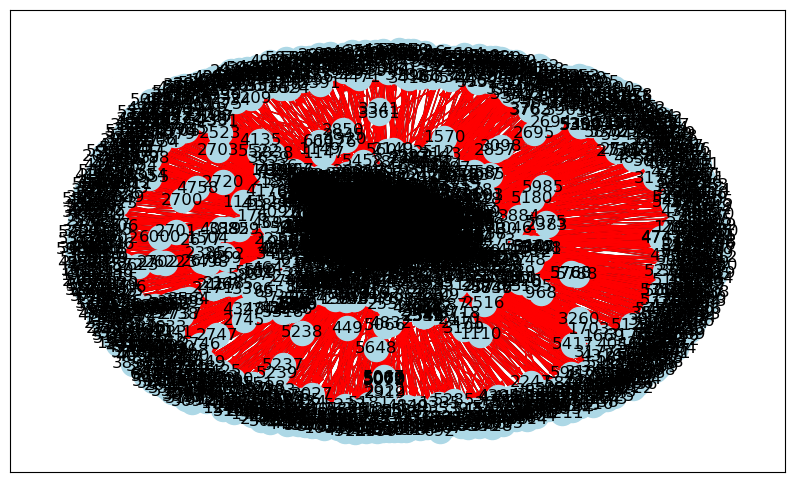

In [11]:
# Création d'un sous-graphe contenant uniquement les liens prédits
predicted_graph = G.copy()
predicted_graph.add_edges_from(predicted_edges)

# Visualisation du graphe avec les liens originaux en noir et les liens prédits en rouge
plt.figure(figsize=(10, 6))
pos = nx.spring_layout(G, seed=42)  # Définition de la disposition des nœuds

# Dessiner les nœuds avec les liens originaux en gris
nx.draw_networkx_nodes(G, pos, node_color='lightblue', node_size=300)
nx.draw_networkx_edges(G, pos, edge_color='black')

# Dessiner les liens prédits en rouge
edges_to_draw = [edge for edge in predicted_graph.edges() if edge[0] in G.nodes() and edge[1] in G.nodes()]
nx.draw_networkx_edges(predicted_graph, pos, edgelist=edges_to_draw, edge_color='red')

# Afficher les labels des nœuds
nx.draw_networkx_labels(G, pos)

# Afficher le graphe
plt.show()

## Attachement préférentiel

noeuds  5881


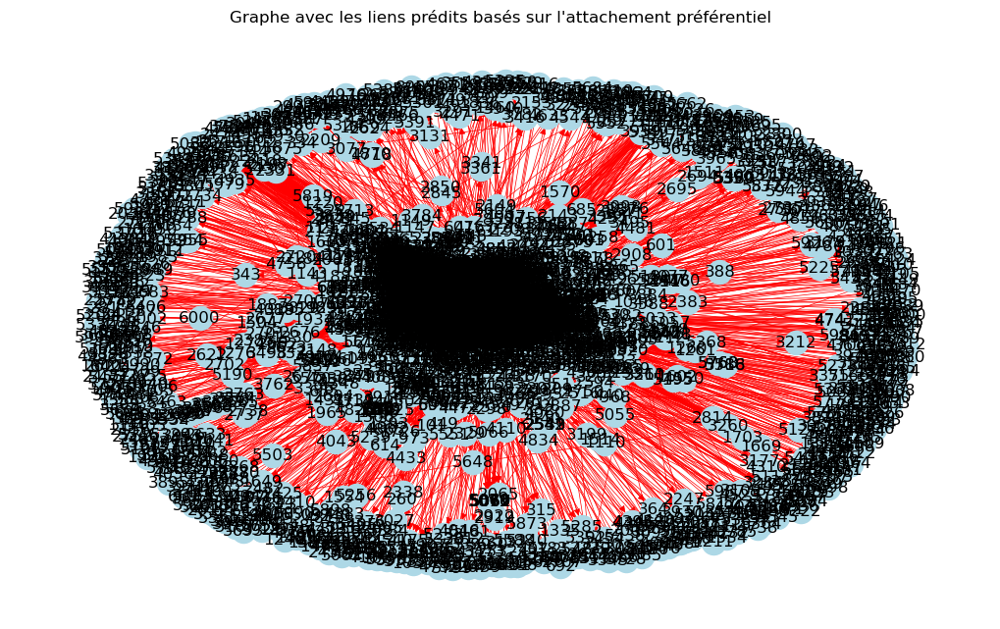

In [2]:
import csv
import random
import networkx as nx
import matplotlib.pyplot as plt

# Lecture du fichier CSV sans spécifier les titres de colonnes
with open('C:/Users/pc/Desktop/soc-sign-bitcoinotc/soc-sign-bitcoinotc.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)  # Ignorer la première ligne si elle contient des en-têtes de colonnes
    data = [line for line in reader]

# Création d'un graphe dirigé
G = nx.DiGraph()

# Ajout des arêtes avec les données du fichier CSV
for edge in data:
    source = edge[0]
    target = edge[1]
    G.add_edge(source, target)

# Liste des nœuds du graphe
nodes = list(G.nodes())

# Prédiction des liens basée sur l'attachement préférentiel
predicted_edges = []
for i in range(1000):  # Prédire 1000 nouveaux liens
    # Sélection aléatoire d'un nouveau nœud et d'un nœud existant
    new_node = random.choice(nodes)
    existing_node = random.choice(nodes)
    # Vérification si le lien existe déjà
    if not G.has_edge(new_node, existing_node):
        predicted_edges.append((new_node, existing_node))

# Ajout des liens prédits au graphe
predicted_graph = G.copy()
predicted_graph.add_edges_from(predicted_edges)
print("noeuds ",predicted_graph.number_of_nodes())
# Visualisation du graphe avec les liens prédits
plt.figure(figsize=(10, 6))
pos = nx.spring_layout(predicted_graph, seed=42)  # Définition de la disposition des nœuds
nx.draw(predicted_graph, pos, with_labels=True, node_color='lightblue', node_size=300, edge_color='red', width=0.5)
plt.title("Graphe avec les liens prédits basés sur l'attachement préférentiel")
plt.show()
